In [1]:
# Import library 
import essentia
import essentia.standard as es
import IPython
# Listen LeadSamples-C4_Clean-18.4.wav
IPython.display.Audio('LeadSamples-C4_Clean-18.4.wav')

In [2]:
# Listen LeadSamples-D4_Clean-17.1.wav
IPython.display.Audio('LeadSamples-D4_Clean-17.1.wav')

In [3]:
# Listen LeadSamples-Eb4_Clean-19.8.wav
IPython.display.Audio('LeadSamples-Eb4_Clean-19.8.wav')

# Audio Feature Extraction 

Text(0.5,1,'Audio waveform for LeadSamples-C4_Clean-18.4.wav')

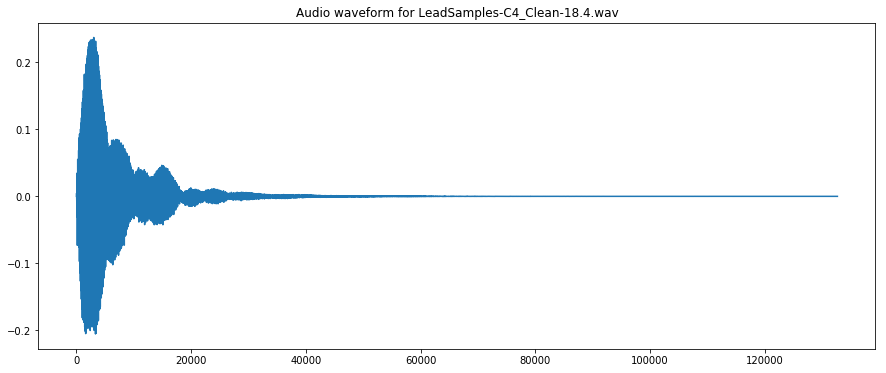

In [4]:
from essentia.standard import *
# Loading audio files
audio1 = MonoLoader(filename='LeadSamples-C4_Clean-18.4.wav')()
audio2 = MonoLoader(filename='LeadSamples-D4_Clean-17.1.wav')()
audio3 = MonoLoader(filename='LeadSamples-Eb4_Clean-19.8.wav')()

from pylab import plot, show, figure, imshow
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (15, 6) # set plot sizes to something larger than default

plot(audio1)

plt.title("Audio waveform for LeadSamples-C4_Clean-18.4.wav")

Text(0.5,1,'Audio waveform for LeadSamples-D4_Clean-17.1.wav')

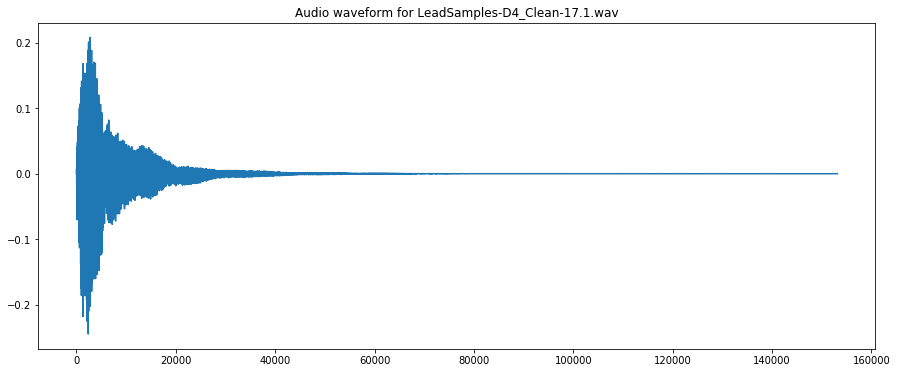

In [5]:
plt.rcParams['figure.figsize'] = (15, 6) # set plot sizes to something larger than default

plot(audio2)

plt.title("Audio waveform for LeadSamples-D4_Clean-17.1.wav")

Text(0.5,1,'LeadSamples-Eb4_Clean-19.8.wav')

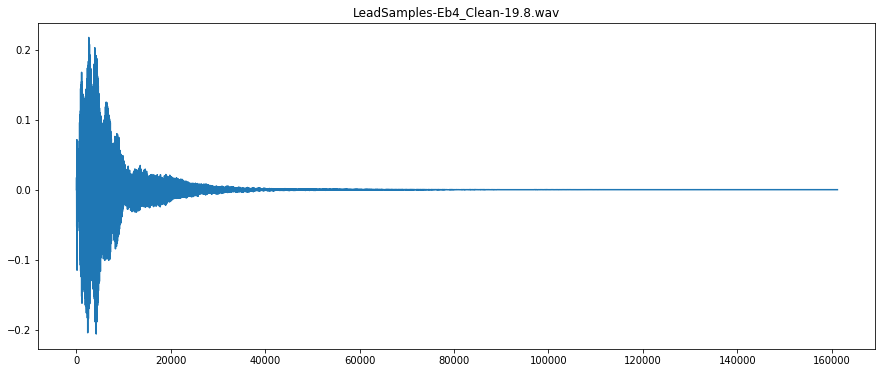

In [6]:
plt.rcParams['figure.figsize'] = (15, 6) # set plot sizes to something larger than default

plot(audio3)

plt.title("LeadSamples-Eb4_Clean-19.8.wav")

Duration of the audio sample [sec]:
3.0092290249433105


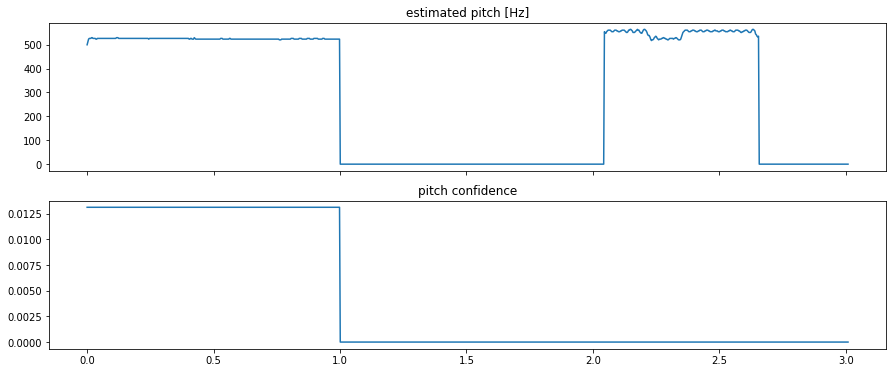

In [7]:
import numpy as np

# Load audio file; it is recommended to apply equal-loudness filter for PredominantPitchMelodia
loader = EqloudLoader(filename='LeadSamples-C4_Clean-18.4.wav', sampleRate=44100)
audio = loader()
print("Duration of the audio sample [sec]:")
print(len(audio)/44100.0)

# Extract the pitch curve
# PitchMelodia takes the entire audio signal as input (no frame-wise processing is required)

pitch_extractor = PredominantPitchMelodia(frameSize=2048, hopSize=128)
pitch_values, pitch_confidence = pitch_extractor(audio)

# Pitch is estimated on frames. Compute frame time positions
pitch_times = np.linspace(0.0,len(audio)/44100.0,len(pitch_values) )

# Plot the estimated pitch contour and confidence over time
f, axarr = plt.subplots(2, sharex=True)
axarr[0].plot(pitch_times, pitch_values)
axarr[0].set_title('estimated pitch [Hz]')
axarr[1].plot(pitch_times, pitch_confidence)
axarr[1].set_title('pitch confidence')
plt.show()

Duration of the audio sample [sec]:
3.473197278911565


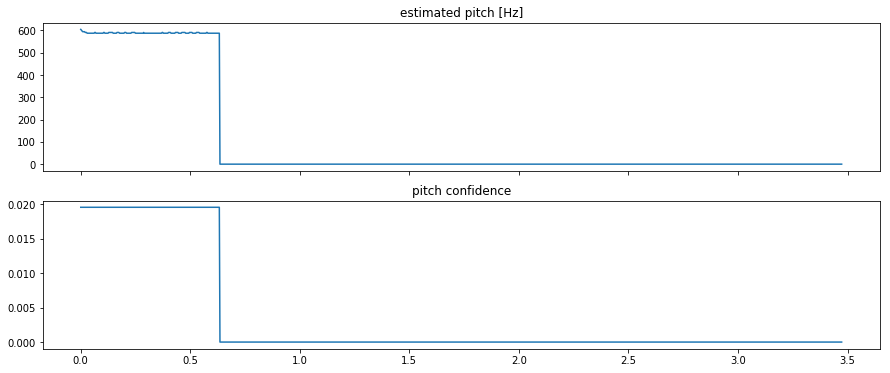

In [8]:
# Load audio file; it is recommended to apply equal-loudness filter for PredominantPitchMelodia
loader = EqloudLoader(filename='LeadSamples-D4_Clean-17.1.wav', sampleRate=44100)
audio = loader()
print("Duration of the audio sample [sec]:")
print(len(audio)/44100.0)

# Extract the pitch curve
# PitchMelodia takes the entire audio signal as input (no frame-wise processing is required)

pitch_extractor = PredominantPitchMelodia(frameSize=2048, hopSize=128)
pitch_values, pitch_confidence = pitch_extractor(audio)

# Pitch is estimated on frames. Compute frame time positions
pitch_times = np.linspace(0.0,len(audio)/44100.0,len(pitch_values) )

# Plot the estimated pitch contour and confidence over time
f, axarr = plt.subplots(2, sharex=True)
axarr[0].plot(pitch_times, pitch_values)
axarr[0].set_title('estimated pitch [Hz]')
axarr[1].plot(pitch_times, pitch_confidence)
axarr[1].set_title('pitch confidence')
plt.show()

Duration of the audio sample [sec]:
3.6561451247165535


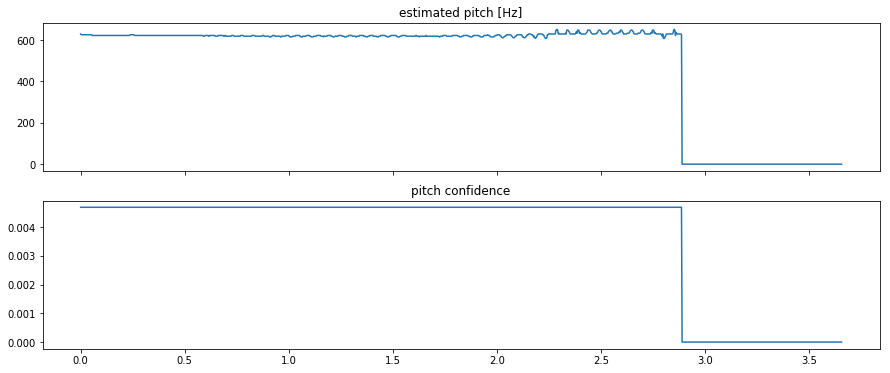

In [9]:
# Load audio file; it is recommended to apply equal-loudness filter for PredominantPitchMelodia
loader = EqloudLoader(filename='LeadSamples-Eb4_Clean-19.8.wav', sampleRate=44100)
audio = loader()
print("Duration of the audio sample [sec]:")
print(len(audio)/44100.0)

# Extract the pitch curve
# PitchMelodia takes the entire audio signal as input (no frame-wise processing is required)

pitch_extractor = PredominantPitchMelodia(frameSize=2048, hopSize=128)
pitch_values, pitch_confidence = pitch_extractor(audio)

# Pitch is estimated on frames. Compute frame time positions
pitch_times = np.linspace(0.0,len(audio)/44100.0,len(pitch_values) )

# Plot the estimated pitch contour and confidence over time
f, axarr = plt.subplots(2, sharex=True)
axarr[0].plot(pitch_times, pitch_values)
axarr[0].set_title('estimated pitch [Hz]')
axarr[1].plot(pitch_times, pitch_confidence)
axarr[1].set_title('pitch confidence')
plt.show()

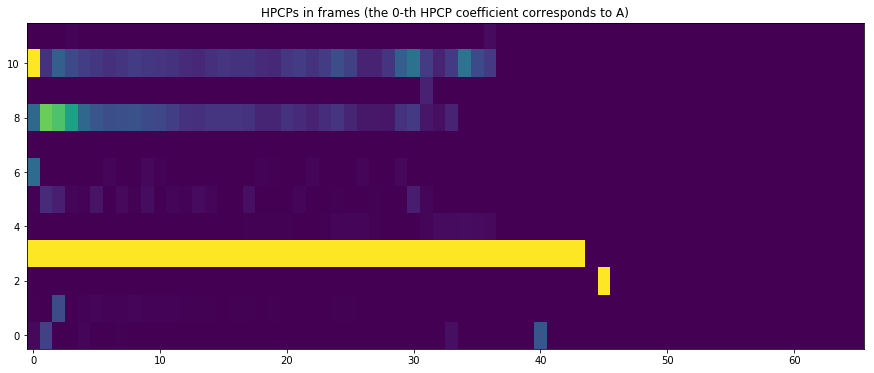

Estimated key and scale: F minor


In [10]:
import essentia.streaming as ess

# Initialize algorithms we will use
loader = ess.MonoLoader(filename='LeadSamples-C4_Clean-18.4.wav')
framecutter = ess.FrameCutter(frameSize=4096, hopSize=2048, silentFrames='noise')
windowing = ess.Windowing(type='blackmanharris62')
spectrum = ess.Spectrum()
spectralpeaks = ess.SpectralPeaks(orderBy='magnitude',
                                  magnitudeThreshold=0.00001,
                                  minFrequency=20,
                                  maxFrequency=3500,
                                  maxPeaks=60)

# Use default HPCP parameters for plots, however we will need higher resolution
# and custom parameters for better Key estimation

hpcp = ess.HPCP()
hpcp_key = ess.HPCP(size=36, # we will need higher resolution for Key estimation
                    referenceFrequency=440, # assume tuning frequency is 44100.
                    bandPreset=False,
                    minFrequency=20,
                    maxFrequency=3500,
                    weightType='cosine',
                    nonLinear=False,
                    windowSize=1.)

key = ess.Key(profileType='edma', # Use profile for electronic music
              numHarmonics=4,
              pcpSize=36,
              slope=0.6,
              usePolyphony=True,
              useThreeChords=True)

# Use pool to store data
pool = essentia.Pool()

# Connect streaming algorithms
loader.audio >> framecutter.signal
framecutter.frame >> windowing.frame >> spectrum.frame
spectrum.spectrum >> spectralpeaks.spectrum
spectralpeaks.magnitudes >> hpcp.magnitudes
spectralpeaks.frequencies >> hpcp.frequencies
spectralpeaks.magnitudes >> hpcp_key.magnitudes
spectralpeaks.frequencies >> hpcp_key.frequencies
hpcp_key.hpcp >> key.pcp
hpcp.hpcp >> (pool, 'tonal.hpcp')
key.key >> (pool, 'tonal.key_key')
key.scale >> (pool, 'tonal.key_scale')
key.strength >> (pool, 'tonal.key_strength')

# Run streaming network
essentia.run(loader)

# Plot HPCP
imshow(pool['tonal.hpcp'].T, aspect='auto', origin='lower', interpolation='none')
plt.title("HPCPs in frames (the 0-th HPCP coefficient corresponds to A)")
show()

print("Estimated key and scale:", pool['tonal.key_key'] + " " + pool['tonal.key_scale'])

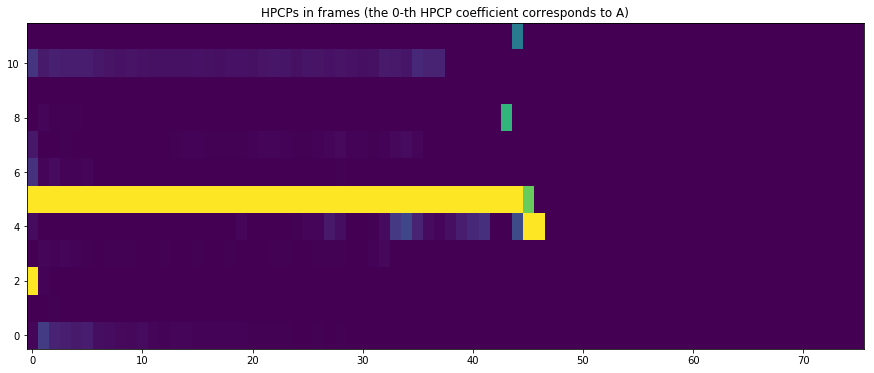

Estimated key and scale: G minor


In [11]:
import essentia.streaming as ess

# Initialize algorithms we will use
loader = ess.MonoLoader(filename='LeadSamples-D4_Clean-17.1.wav')
framecutter = ess.FrameCutter(frameSize=4096, hopSize=2048, silentFrames='noise')
windowing = ess.Windowing(type='blackmanharris62')
spectrum = ess.Spectrum()
spectralpeaks = ess.SpectralPeaks(orderBy='magnitude',
                                  magnitudeThreshold=0.00001,
                                  minFrequency=20,
                                  maxFrequency=3500,
                                  maxPeaks=60)

# Use default HPCP parameters for plots, however we will need higher resolution
# and custom parameters for better Key estimation

hpcp = ess.HPCP()
hpcp_key = ess.HPCP(size=36, # we will need higher resolution for Key estimation
                    referenceFrequency=440, # assume tuning frequency is 44100.
                    bandPreset=False,
                    minFrequency=20,
                    maxFrequency=3500,
                    weightType='cosine',
                    nonLinear=False,
                    windowSize=1.)

key = ess.Key(profileType='edma', # Use profile for electronic music
              numHarmonics=4,
              pcpSize=36,
              slope=0.6,
              usePolyphony=True,
              useThreeChords=True)

# Use pool to store data
pool = essentia.Pool()

# Connect streaming algorithms
loader.audio >> framecutter.signal
framecutter.frame >> windowing.frame >> spectrum.frame
spectrum.spectrum >> spectralpeaks.spectrum
spectralpeaks.magnitudes >> hpcp.magnitudes
spectralpeaks.frequencies >> hpcp.frequencies
spectralpeaks.magnitudes >> hpcp_key.magnitudes
spectralpeaks.frequencies >> hpcp_key.frequencies
hpcp_key.hpcp >> key.pcp
hpcp.hpcp >> (pool, 'tonal.hpcp')
key.key >> (pool, 'tonal.key_key')
key.scale >> (pool, 'tonal.key_scale')
key.strength >> (pool, 'tonal.key_strength')

# Run streaming network
essentia.run(loader)

# Plot HPCP
imshow(pool['tonal.hpcp'].T, aspect='auto', origin='lower', interpolation='none')
plt.title("HPCPs in frames (the 0-th HPCP coefficient corresponds to A)")
show()

print("Estimated key and scale:", pool['tonal.key_key'] + " " + pool['tonal.key_scale'])

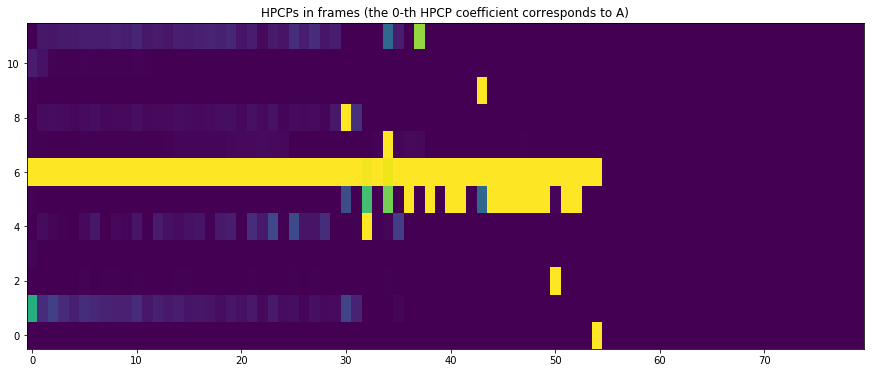

Estimated key and scale: Ab minor


In [12]:
import essentia.streaming as ess

# Initialize algorithms we will use
loader = ess.MonoLoader(filename='LeadSamples-Eb4_Clean-19.8.wav')
framecutter = ess.FrameCutter(frameSize=4096, hopSize=2048, silentFrames='noise')
windowing = ess.Windowing(type='blackmanharris62')
spectrum = ess.Spectrum()
spectralpeaks = ess.SpectralPeaks(orderBy='magnitude',
                                  magnitudeThreshold=0.00001,
                                  minFrequency=20,
                                  maxFrequency=3500,
                                  maxPeaks=60)

# Use default HPCP parameters for plots, however we will need higher resolution
# and custom parameters for better Key estimation

hpcp = ess.HPCP()
hpcp_key = ess.HPCP(size=36, # we will need higher resolution for Key estimation
                    referenceFrequency=440, # assume tuning frequency is 44100.
                    bandPreset=False,
                    minFrequency=20,
                    maxFrequency=3500,
                    weightType='cosine',
                    nonLinear=False,
                    windowSize=1.)

key = ess.Key(profileType='edma', # Use profile for electronic music
              numHarmonics=4,
              pcpSize=36,
              slope=0.6,
              usePolyphony=True,
              useThreeChords=True)

# Use pool to store data
pool = essentia.Pool()

# Connect streaming algorithms
loader.audio >> framecutter.signal
framecutter.frame >> windowing.frame >> spectrum.frame
spectrum.spectrum >> spectralpeaks.spectrum
spectralpeaks.magnitudes >> hpcp.magnitudes
spectralpeaks.frequencies >> hpcp.frequencies
spectralpeaks.magnitudes >> hpcp_key.magnitudes
spectralpeaks.frequencies >> hpcp_key.frequencies
hpcp_key.hpcp >> key.pcp
hpcp.hpcp >> (pool, 'tonal.hpcp')
key.key >> (pool, 'tonal.key_key')
key.scale >> (pool, 'tonal.key_scale')
key.strength >> (pool, 'tonal.key_strength')

# Run streaming network
essentia.run(loader)

# Plot HPCP
imshow(pool['tonal.hpcp'].T, aspect='auto', origin='lower', interpolation='none')
plt.title("HPCPs in frames (the 0-th HPCP coefficient corresponds to A)")
show()

print("Estimated key and scale:", pool['tonal.key_key'] + " " + pool['tonal.key_scale'])

In [13]:
import librosa
y, sr = librosa.load('LeadSamples-C4_Clean-18.4.wav')
librosa.feature.rms(y=y)

array([[9.54580158e-02, 1.03042006e-01, 1.17011048e-01, 1.20807163e-01,
        1.07498161e-01, 8.39854181e-02, 6.14111498e-02, 4.83395308e-02,
        4.20697927e-02, 3.39457020e-02, 2.48733182e-02, 1.98611133e-02,
        2.00370029e-02, 2.14601289e-02, 2.20529232e-02, 2.13931799e-02,
        1.87835377e-02, 1.41912755e-02, 9.33827180e-03, 6.20291755e-03,
        5.66203520e-03, 5.50504122e-03, 5.03365928e-03, 4.65159956e-03,
        4.43608314e-03, 3.99415940e-03, 3.31763085e-03, 2.90413853e-03,
        2.75276904e-03, 2.63018417e-03, 2.44668708e-03, 2.13922095e-03,
        1.79344276e-03, 1.58983842e-03, 1.47243333e-03, 1.39817083e-03,
        1.34250673e-03, 1.25622354e-03, 1.13373541e-03, 1.01615349e-03,
        9.08423041e-04, 7.98889669e-04, 6.98179472e-04, 6.20585226e-04,
        5.50880388e-04, 4.97405184e-04, 4.56164737e-04, 4.17742151e-04,
        3.94133356e-04, 3.76363430e-04, 3.48066562e-04, 3.14019970e-04,
        2.80431297e-04, 2.56838423e-04, 2.45625793e-04, 2.398693

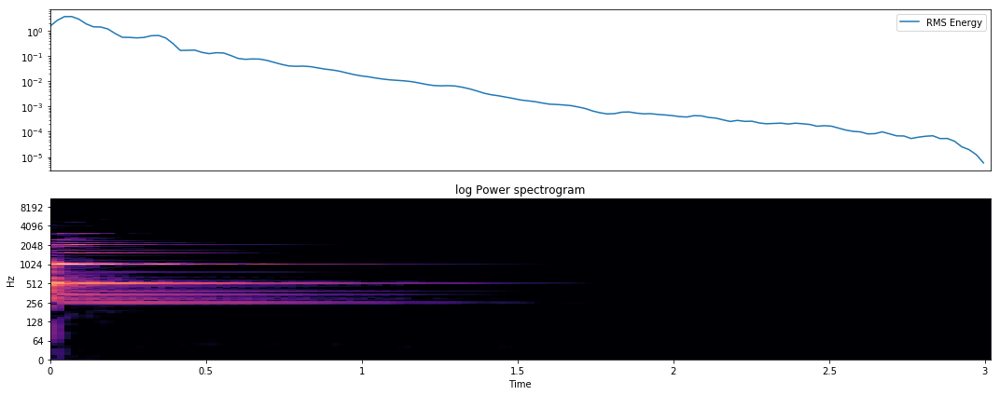

In [14]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
y, sr = librosa.load('LeadSamples-C4_Clean-18.4.wav')
librosa.feature.rms(y=y)
# array([[ 0.   ,  0.056, ...,  0.   ,  0.   ]], dtype=float32)

# Or from spectrogram input

S, phase = librosa.magphase(librosa.stft(y))
rms = librosa.feature.rms(S=S)

plt.figure()
plt.subplot(2, 1, 1)
plt.semilogy(rms.T, label='RMS Energy')
plt.xticks([])
plt.xlim([0, rms.shape[-1]])
plt.legend()
plt.subplot(2, 1, 2)
librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                         y_axis='log', x_axis='time')
plt.title('log Power spectrogram')
plt.tight_layout()

# Use a STFT window of constant ones and no frame centering to get consistent
# results with the RMS computed from the audio samples `y`

S = librosa.magphase(librosa.stft(y, window=np.ones, center=False))[0]
librosa.feature.rms(S=S)
plt.show()

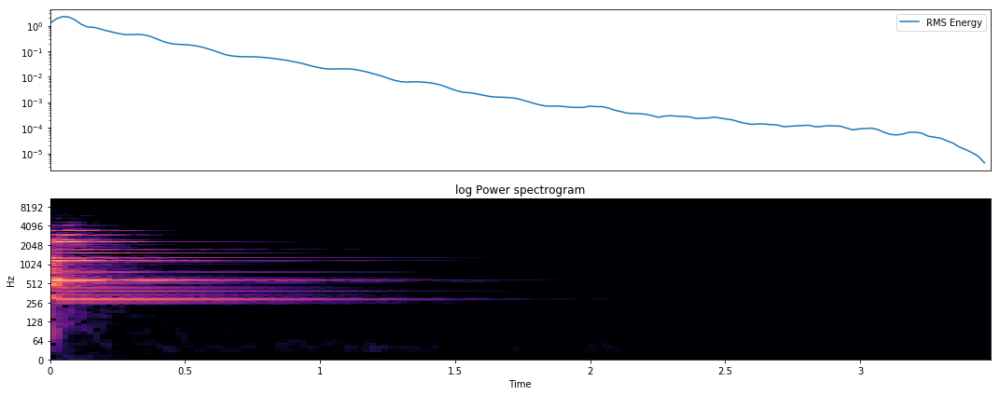

In [15]:
y, sr = librosa.load('LeadSamples-D4_Clean-17.1.wav')
librosa.feature.rms(y=y)
# array([[ 0.   ,  0.056, ...,  0.   ,  0.   ]], dtype=float32)

# Or from spectrogram input

S, phase = librosa.magphase(librosa.stft(y))
rms = librosa.feature.rms(S=S)

plt.figure()
plt.subplot(2, 1, 1)
plt.semilogy(rms.T, label='RMS Energy')
plt.xticks([])
plt.xlim([0, rms.shape[-1]])
plt.legend()
plt.subplot(2, 1, 2)
librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                         y_axis='log', x_axis='time')
plt.title('log Power spectrogram')
plt.tight_layout()

# Use a STFT window of constant ones and no frame centering to get consistent
# results with the RMS computed from the audio samples `y`

S = librosa.magphase(librosa.stft(y, window=np.ones, center=False))[0]
librosa.feature.rms(S=S)
plt.show()

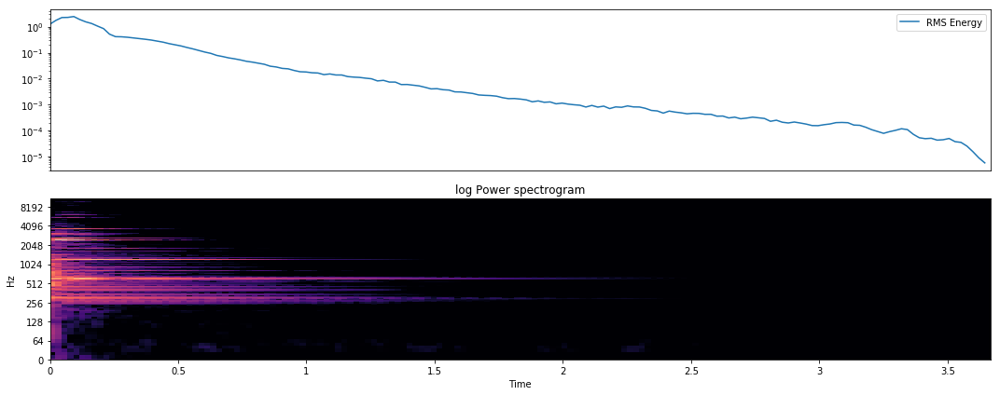

In [16]:
y, sr = librosa.load('LeadSamples-Eb4_Clean-19.8.wav')
librosa.feature.rms(y=y)
# array([[ 0.   ,  0.056, ...,  0.   ,  0.   ]], dtype=float32)

# Or from spectrogram input

S, phase = librosa.magphase(librosa.stft(y))
rms = librosa.feature.rms(S=S)

plt.figure()
plt.subplot(2, 1, 1)
plt.semilogy(rms.T, label='RMS Energy')
plt.xticks([])
plt.xlim([0, rms.shape[-1]])
plt.legend()
plt.subplot(2, 1, 2)
librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                         y_axis='log', x_axis='time')
plt.title('log Power spectrogram')
plt.tight_layout()

# Use a STFT window of constant ones and no frame centering to get consistent
# results with the RMS computed from the audio samples `y`

S = librosa.magphase(librosa.stft(y, window=np.ones, center=False))[0]
librosa.feature.rms(S=S)
plt.show()

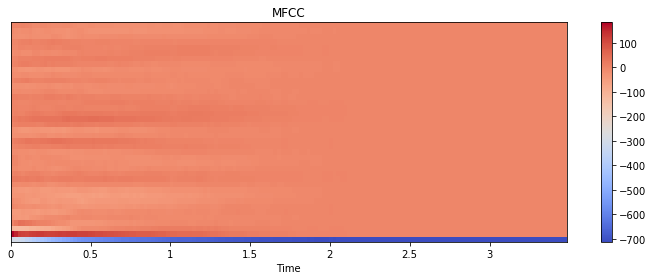

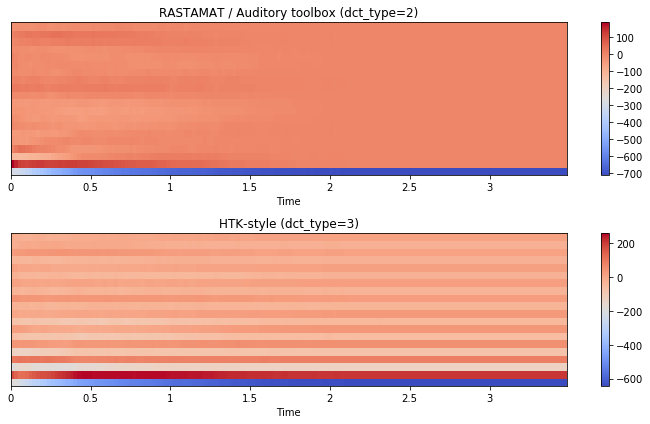

In [17]:
# Generate mfccs from a time series
y, sr = librosa.load('LeadSamples-D4_Clean-17.1.wav')
librosa.feature.mfcc(y=y, sr=sr)
# array([[ -5.229e+02,  -4.944e+02, ...,  -5.229e+02,  -5.229e+02],
# [  7.105e-15,   3.787e+01, ...,  -7.105e-15,  -7.105e-15],
# ...,
# [  1.066e-14,  -7.500e+00, ...,   1.421e-14,   1.421e-14],
# [  3.109e-14,  -5.058e+00, ...,   2.931e-14,   2.931e-14]])

# Using a different hop length and HTK-style Mel frequencies

librosa.feature.mfcc(y=y, sr=sr, hop_length=1024, htk=True)
# array([[-1.628e+02, -8.903e+01, -1.409e+02, ..., -1.078e+02,
# -2.504e+02, -2.393e+02],
# [ 1.275e+02,  9.532e+01,  1.019e+02, ...,  1.152e+02,
# 2.224e+02,  1.750e+02],
# [ 1.139e+01,  6.155e+00,  1.266e+01, ...,  4.557e+01,
# 4.585e+01,  3.985e+01],
# ...,
# [ 3.462e+00,  4.032e+00, -5.694e-01, ..., -6.677e+00,
# -1.183e-01,  1.485e+00],
# [ 9.569e-01,  1.069e+00, -6.865e+00, ..., -9.598e+00,
# -1.611e+00, -6.716e+00],
# [ 8.457e+00,  3.582e+00, -1.156e-01, ..., -3.018e+00,
# -1.456e+01, -6.991e+00]], dtype=float32)

# Use a pre-computed log-power Mel spectrogram

S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                   fmax=8000)
librosa.feature.mfcc(S=librosa.power_to_db(S))
# array([[ -5.207e+02,  -4.898e+02, ...,  -5.207e+02,  -5.207e+02],
# [ -2.576e-14,   4.054e+01, ...,  -3.997e-14,  -3.997e-14],
# ...,
# [  7.105e-15,  -3.534e+00, ...,   0.000e+00,   0.000e+00],
# [  3.020e-14,  -2.613e+00, ...,   3.553e-14,   3.553e-14]])

# Get more components

mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=40)

# Visualize the MFCC series

plt.figure(figsize=(10, 4))
librosa.display.specshow(mfccs, x_axis='time')
plt.colorbar()
plt.title('MFCC')
plt.tight_layout()
plt.show()

# Compare different DCT bases

m_slaney = librosa.feature.mfcc(y=y, sr=sr, dct_type=2)
m_htk = librosa.feature.mfcc(y=y, sr=sr, dct_type=3)
plt.figure(figsize=(10, 6))
plt.subplot(2, 1, 1)
librosa.display.specshow(m_slaney, x_axis='time')
plt.title('RASTAMAT / Auditory toolbox (dct_type=2)')
plt.colorbar()
plt.subplot(2, 1, 2)
librosa.display.specshow(m_htk, x_axis='time')
plt.title('HTK-style (dct_type=3)')
plt.colorbar()
plt.tight_layout()
plt.show()


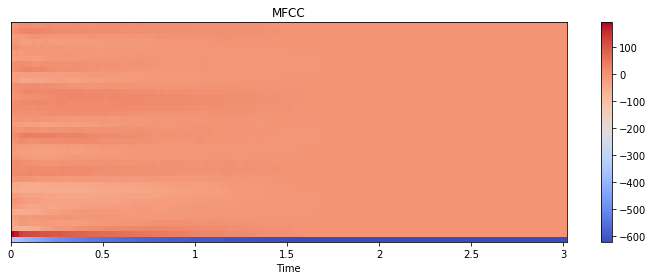

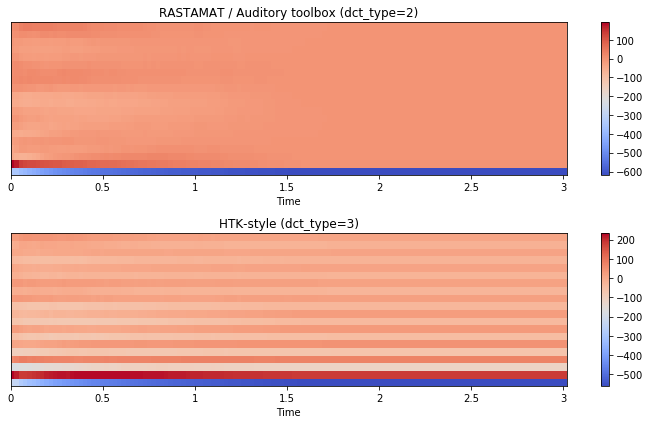

In [18]:
# Generate mfccs from a time series
y, sr = librosa.load('LeadSamples-C4_Clean-18.4.wav')
librosa.feature.mfcc(y=y, sr=sr)
# array([[ -5.229e+02,  -4.944e+02, ...,  -5.229e+02,  -5.229e+02],
# [  7.105e-15,   3.787e+01, ...,  -7.105e-15,  -7.105e-15],
# ...,
# [  1.066e-14,  -7.500e+00, ...,   1.421e-14,   1.421e-14],
# [  3.109e-14,  -5.058e+00, ...,   2.931e-14,   2.931e-14]])

# Using a different hop length and HTK-style Mel frequencies

librosa.feature.mfcc(y=y, sr=sr, hop_length=1024, htk=True)
# array([[-1.628e+02, -8.903e+01, -1.409e+02, ..., -1.078e+02,
# -2.504e+02, -2.393e+02],
# [ 1.275e+02,  9.532e+01,  1.019e+02, ...,  1.152e+02,
# 2.224e+02,  1.750e+02],
# [ 1.139e+01,  6.155e+00,  1.266e+01, ...,  4.557e+01,
# 4.585e+01,  3.985e+01],
# ...,
# [ 3.462e+00,  4.032e+00, -5.694e-01, ..., -6.677e+00,
# -1.183e-01,  1.485e+00],
# [ 9.569e-01,  1.069e+00, -6.865e+00, ..., -9.598e+00,
# -1.611e+00, -6.716e+00],
# [ 8.457e+00,  3.582e+00, -1.156e-01, ..., -3.018e+00,
# -1.456e+01, -6.991e+00]], dtype=float32)

# Use a pre-computed log-power Mel spectrogram

S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                   fmax=8000)
librosa.feature.mfcc(S=librosa.power_to_db(S))
# array([[ -5.207e+02,  -4.898e+02, ...,  -5.207e+02,  -5.207e+02],
# [ -2.576e-14,   4.054e+01, ...,  -3.997e-14,  -3.997e-14],
# ...,
# [  7.105e-15,  -3.534e+00, ...,   0.000e+00,   0.000e+00],
# [  3.020e-14,  -2.613e+00, ...,   3.553e-14,   3.553e-14]])

# Get more components

mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=40)

# Visualize the MFCC series

plt.figure(figsize=(10, 4))
librosa.display.specshow(mfccs, x_axis='time')
plt.colorbar()
plt.title('MFCC')
plt.tight_layout()
plt.show()

# Compare different DCT bases

m_slaney = librosa.feature.mfcc(y=y, sr=sr, dct_type=2)
m_htk = librosa.feature.mfcc(y=y, sr=sr, dct_type=3)
plt.figure(figsize=(10, 6))
plt.subplot(2, 1, 1)
librosa.display.specshow(m_slaney, x_axis='time')
plt.title('RASTAMAT / Auditory toolbox (dct_type=2)')
plt.colorbar()
plt.subplot(2, 1, 2)
librosa.display.specshow(m_htk, x_axis='time')
plt.title('HTK-style (dct_type=3)')
plt.colorbar()
plt.tight_layout()
plt.show()


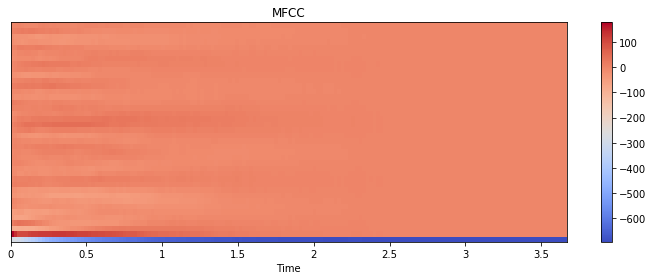

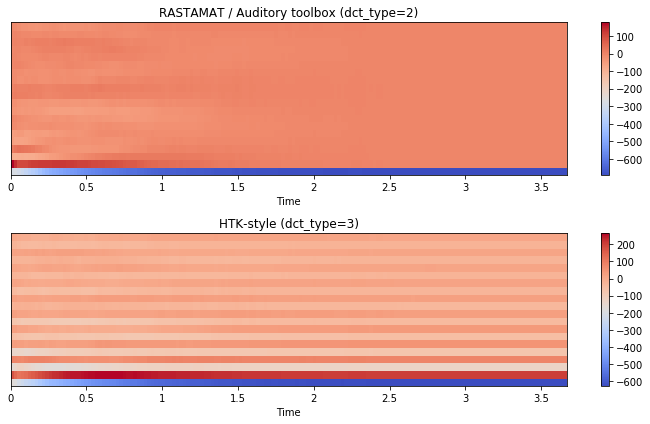

In [19]:
# Generate mfccs from a time series
y, sr = librosa.load('LeadSamples-Eb4_Clean-19.8.wav')
librosa.feature.mfcc(y=y, sr=sr)
# array([[ -5.229e+02,  -4.944e+02, ...,  -5.229e+02,  -5.229e+02],
# [  7.105e-15,   3.787e+01, ...,  -7.105e-15,  -7.105e-15],
# ...,
# [  1.066e-14,  -7.500e+00, ...,   1.421e-14,   1.421e-14],
# [  3.109e-14,  -5.058e+00, ...,   2.931e-14,   2.931e-14]])

# Using a different hop length and HTK-style Mel frequencies

librosa.feature.mfcc(y=y, sr=sr, hop_length=1024, htk=True)
# array([[-1.628e+02, -8.903e+01, -1.409e+02, ..., -1.078e+02,
# -2.504e+02, -2.393e+02],
# [ 1.275e+02,  9.532e+01,  1.019e+02, ...,  1.152e+02,
# 2.224e+02,  1.750e+02],
# [ 1.139e+01,  6.155e+00,  1.266e+01, ...,  4.557e+01,
# 4.585e+01,  3.985e+01],
# ...,
# [ 3.462e+00,  4.032e+00, -5.694e-01, ..., -6.677e+00,
# -1.183e-01,  1.485e+00],
# [ 9.569e-01,  1.069e+00, -6.865e+00, ..., -9.598e+00,
# -1.611e+00, -6.716e+00],
# [ 8.457e+00,  3.582e+00, -1.156e-01, ..., -3.018e+00,
# -1.456e+01, -6.991e+00]], dtype=float32)

# Use a pre-computed log-power Mel spectrogram

S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                   fmax=8000)
librosa.feature.mfcc(S=librosa.power_to_db(S))
# array([[ -5.207e+02,  -4.898e+02, ...,  -5.207e+02,  -5.207e+02],
# [ -2.576e-14,   4.054e+01, ...,  -3.997e-14,  -3.997e-14],
# ...,
# [  7.105e-15,  -3.534e+00, ...,   0.000e+00,   0.000e+00],
# [  3.020e-14,  -2.613e+00, ...,   3.553e-14,   3.553e-14]])

# Get more components

mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=40)

# Visualize the MFCC series

plt.figure(figsize=(10, 4))
librosa.display.specshow(mfccs, x_axis='time')
plt.colorbar()
plt.title('MFCC')
plt.tight_layout()
plt.show()

# Compare different DCT bases

m_slaney = librosa.feature.mfcc(y=y, sr=sr, dct_type=2)
m_htk = librosa.feature.mfcc(y=y, sr=sr, dct_type=3)
plt.figure(figsize=(10, 6))
plt.subplot(2, 1, 1)
librosa.display.specshow(m_slaney, x_axis='time')
plt.title('RASTAMAT / Auditory toolbox (dct_type=2)')
plt.colorbar()
plt.subplot(2, 1, 2)
librosa.display.specshow(m_htk, x_axis='time')
plt.title('HTK-style (dct_type=3)')
plt.colorbar()
plt.tight_layout()
plt.show()


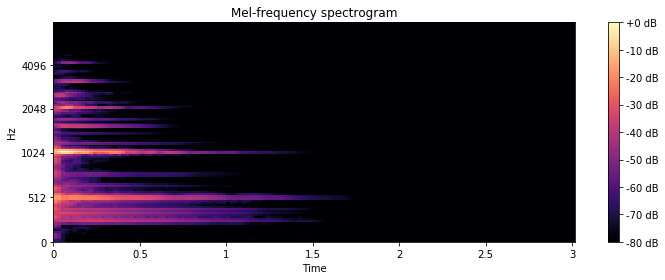

In [20]:
y, sr = librosa.load('LeadSamples-C4_Clean-18.4.wav')
librosa.feature.melspectrogram(y=y, sr=sr)
# array([[  2.891e-07,   2.548e-03, ...,   8.116e-09,   5.633e-09],
# [  1.986e-07,   1.162e-02, ...,   9.332e-08,   6.716e-09],
# ...,
# [  3.668e-09,   2.029e-08, ...,   3.208e-09,   2.864e-09],
# [  2.561e-10,   2.096e-09, ...,   7.543e-10,   6.101e-10]])

# Using a pre-computed power spectrogram would give the same result:

D = np.abs(librosa.stft(y))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)

# Display of mel-frequency spectrogram coefficients, with custom
# arguments for mel filterbank construction (default is fmax=sr/2):

# Passing through arguments to the Mel filters
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                    fmax=8000)

plt.figure(figsize=(10, 4))
S_dB = librosa.power_to_db(S, ref=np.max)
librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel-frequency spectrogram')
plt.tight_layout()
plt.show()


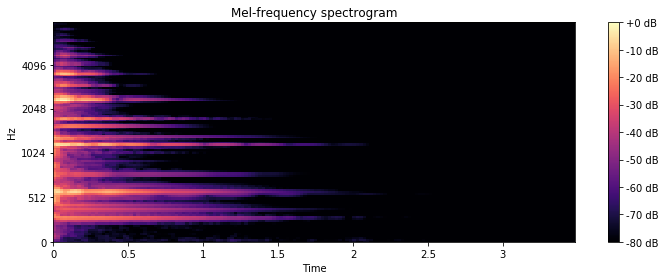

In [21]:
y, sr = librosa.load('LeadSamples-D4_Clean-17.1.wav')
librosa.feature.melspectrogram(y=y, sr=sr)
# array([[  2.891e-07,   2.548e-03, ...,   8.116e-09,   5.633e-09],
# [  1.986e-07,   1.162e-02, ...,   9.332e-08,   6.716e-09],
# ...,
# [  3.668e-09,   2.029e-08, ...,   3.208e-09,   2.864e-09],
# [  2.561e-10,   2.096e-09, ...,   7.543e-10,   6.101e-10]])

# Using a pre-computed power spectrogram would give the same result:

D = np.abs(librosa.stft(y))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)

# Display of mel-frequency spectrogram coefficients, with custom
# arguments for mel filterbank construction (default is fmax=sr/2):

# Passing through arguments to the Mel filters
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                    fmax=8000)
plt.figure(figsize=(10, 4))
S_dB = librosa.power_to_db(S, ref=np.max)
librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel-frequency spectrogram')
plt.tight_layout()
plt.show()

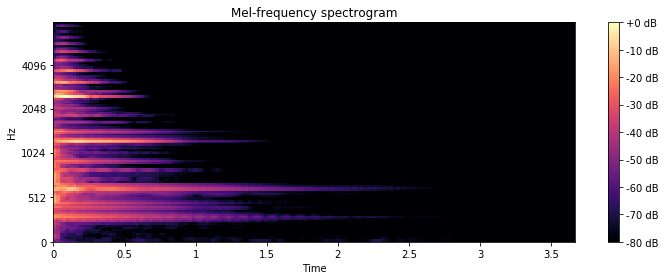

In [22]:
y, sr = librosa.load('LeadSamples-Eb4_Clean-19.8.wav')
librosa.feature.melspectrogram(y=y, sr=sr)
# array([[  2.891e-07,   2.548e-03, ...,   8.116e-09,   5.633e-09],
# [  1.986e-07,   1.162e-02, ...,   9.332e-08,   6.716e-09],
# ...,
# [  3.668e-09,   2.029e-08, ...,   3.208e-09,   2.864e-09],
# [  2.561e-10,   2.096e-09, ...,   7.543e-10,   6.101e-10]])

# Using a pre-computed power spectrogram would give the same result:

D = np.abs(librosa.stft(y))**2
S = librosa.feature.melspectrogram(S=D, sr=sr)

# Display of mel-frequency spectrogram coefficients, with custom
# arguments for mel filterbank construction (default is fmax=sr/2):

# Passing through arguments to the Mel filters
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                    fmax=8000)

plt.figure(figsize=(10, 4))
S_dB = librosa.power_to_db(S, ref=np.max)
librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000)
plt.colorbar(format='%+2.0f dB')
plt.title('Mel-frequency spectrogram')
plt.tight_layout()
plt.show()

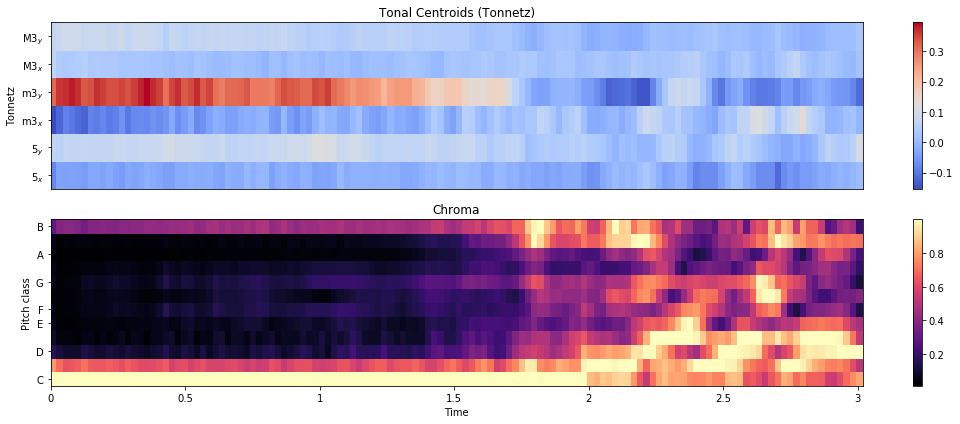

In [23]:
# Compute tonnetz features from the harmonic component of a song

y, sr = librosa.load('LeadSamples-C4_Clean-18.4.wav')
y = librosa.effects.harmonic(y)
tonnetz = librosa.feature.tonnetz(y=y, sr=sr)
tonnetz
# array([[-0.073, -0.053, ..., -0.054, -0.073],
# [ 0.001,  0.001, ..., -0.054, -0.062],
# ...,
# [ 0.039,  0.034, ...,  0.044,  0.064],
# [ 0.005,  0.002, ...,  0.011,  0.017]])

# Compare the tonnetz features to `chroma_cqt`

plt.subplot(2, 1, 1)
librosa.display.specshow(tonnetz, y_axis='tonnetz')
plt.colorbar()
plt.title('Tonal Centroids (Tonnetz)')
plt.subplot(2, 1, 2)
librosa.display.specshow(librosa.feature.chroma_cqt(y, sr=sr),
                         y_axis='chroma', x_axis='time')
plt.colorbar()
plt.title('Chroma')
plt.tight_layout()
plt.show()


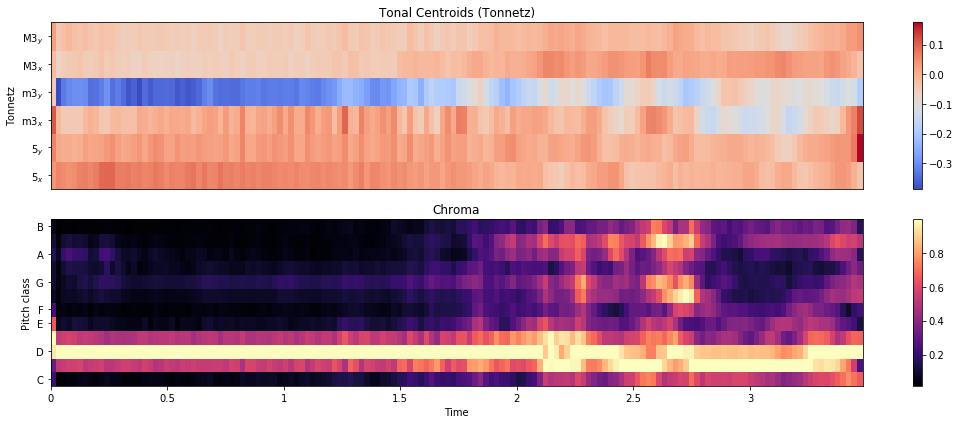

In [24]:
# Compute tonnetz features from the harmonic component of a song

y, sr = librosa.load('LeadSamples-D4_Clean-17.1.wav')
y = librosa.effects.harmonic(y)
tonnetz = librosa.feature.tonnetz(y=y, sr=sr)
tonnetz
# array([[-0.073, -0.053, ..., -0.054, -0.073],
# [ 0.001,  0.001, ..., -0.054, -0.062],
# ...,
# [ 0.039,  0.034, ...,  0.044,  0.064],
# [ 0.005,  0.002, ...,  0.011,  0.017]])

# Compare the tonnetz features to `chroma_cqt`

plt.subplot(2, 1, 1)
librosa.display.specshow(tonnetz, y_axis='tonnetz')
plt.colorbar()
plt.title('Tonal Centroids (Tonnetz)')
plt.subplot(2, 1, 2)
librosa.display.specshow(librosa.feature.chroma_cqt(y, sr=sr),
                         y_axis='chroma', x_axis='time')
plt.colorbar()
plt.title('Chroma')
plt.tight_layout()
plt.show()

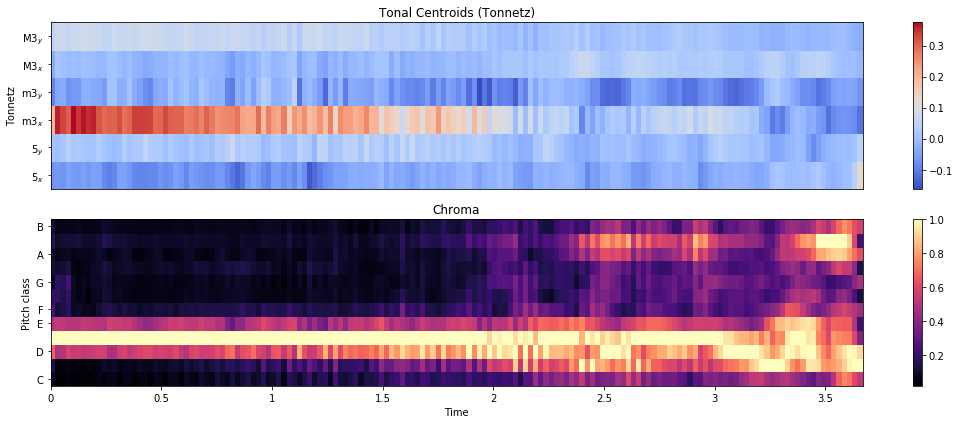

In [25]:
# Compute tonnetz features from the harmonic component of a song

y, sr = librosa.load('LeadSamples-Eb4_Clean-19.8.wav')
y = librosa.effects.harmonic(y)
tonnetz = librosa.feature.tonnetz(y=y, sr=sr)
tonnetz
# array([[-0.073, -0.053, ..., -0.054, -0.073],
# [ 0.001,  0.001, ..., -0.054, -0.062],
# ...,
# [ 0.039,  0.034, ...,  0.044,  0.064],
# [ 0.005,  0.002, ...,  0.011,  0.017]])

# Compare the tonnetz features to `chroma_cqt`


plt.subplot(2, 1, 1)
librosa.display.specshow(tonnetz, y_axis='tonnetz')
plt.colorbar()
plt.title('Tonal Centroids (Tonnetz)')
plt.subplot(2, 1, 2)
librosa.display.specshow(librosa.feature.chroma_cqt(y, sr=sr),
                         y_axis='chroma', x_axis='time')
plt.colorbar()
plt.title('Chroma')
plt.tight_layout()
plt.show()

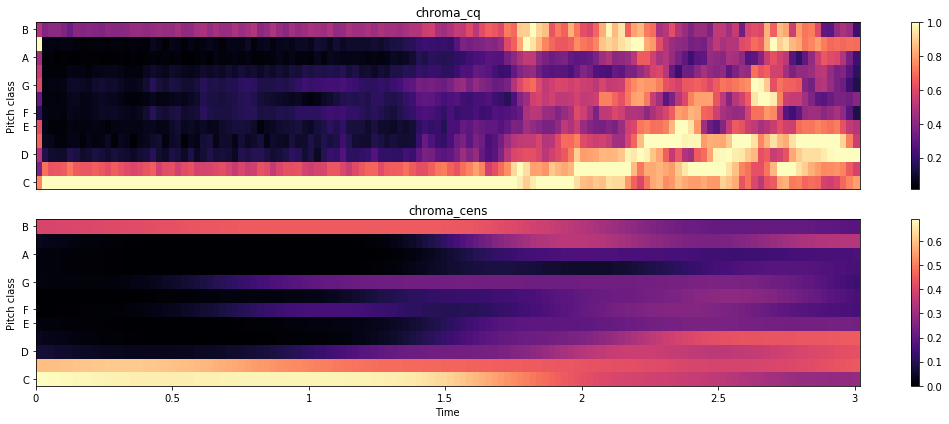

In [26]:
# Compare standard cqt chroma to CENS.

y, sr = librosa.load('LeadSamples-C4_Clean-18.4.wav')
chroma_cens = librosa.feature.chroma_cens(y=y, sr=sr)
chroma_cq = librosa.feature.chroma_cqt(y=y, sr=sr)


plt.figure()
plt.subplot(2,1,1)
librosa.display.specshow(chroma_cq, y_axis='chroma')
plt.title('chroma_cq')
plt.colorbar()
plt.subplot(2,1,2)
librosa.display.specshow(chroma_cens, y_axis='chroma', x_axis='time')
plt.title('chroma_cens')
plt.colorbar()
plt.tight_layout()
plt.show()


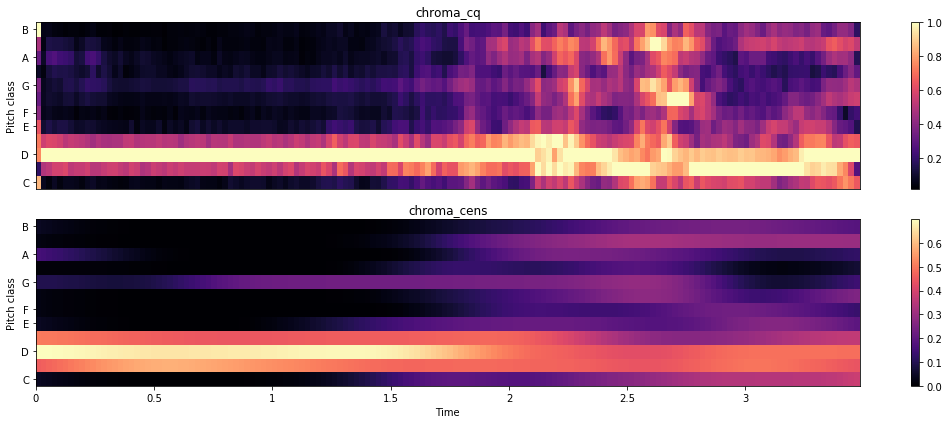

In [27]:
# Compare standard cqt chroma to CENS.

y, sr = librosa.load('LeadSamples-D4_Clean-17.1.wav')
chroma_cens = librosa.feature.chroma_cens(y=y, sr=sr)
chroma_cq = librosa.feature.chroma_cqt(y=y, sr=sr)

plt.figure()
plt.subplot(2,1,1)
librosa.display.specshow(chroma_cq, y_axis='chroma')
plt.title('chroma_cq')
plt.colorbar()
plt.subplot(2,1,2)
librosa.display.specshow(chroma_cens, y_axis='chroma', x_axis='time')
plt.title('chroma_cens')
plt.colorbar()
plt.tight_layout()
plt.show()

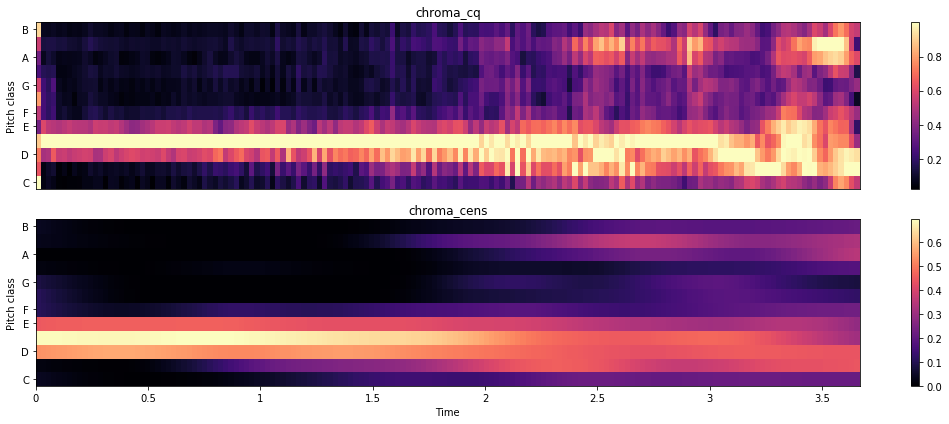

In [28]:
# Compare standard cqt chroma to CENS.

y, sr = librosa.load('LeadSamples-Eb4_Clean-19.8.wav')
chroma_cens = librosa.feature.chroma_cens(y=y, sr=sr)
chroma_cq = librosa.feature.chroma_cqt(y=y, sr=sr)


plt.figure()
plt.subplot(2,1,1)
librosa.display.specshow(chroma_cq, y_axis='chroma')
plt.title('chroma_cq')
plt.colorbar()
plt.subplot(2,1,2)
librosa.display.specshow(chroma_cens, y_axis='chroma', x_axis='time')
plt.title('chroma_cens')
plt.colorbar()
plt.tight_layout()
plt.show()

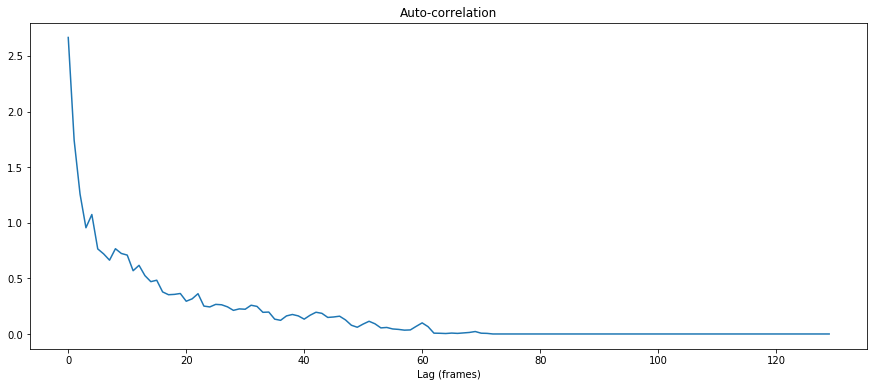

In [29]:
# Compute full autocorrelation of y

y, sr = librosa.load('LeadSamples-C4_Clean-18.4.wav')
librosa.autocorrelate(y)
# array([  3.226e+03,   3.217e+03, ...,   8.277e-04,   3.575e-04], dtype=float32)

# Compute onset strength auto-correlation up to 4 seconds

odf = librosa.onset.onset_strength(y=y, sr=sr, hop_length=512)
ac = librosa.autocorrelate(odf, max_size=4* sr / 512)
plt.plot(ac)
plt.title('Auto-correlation')
plt.xlabel('Lag (frames)')
plt.show()

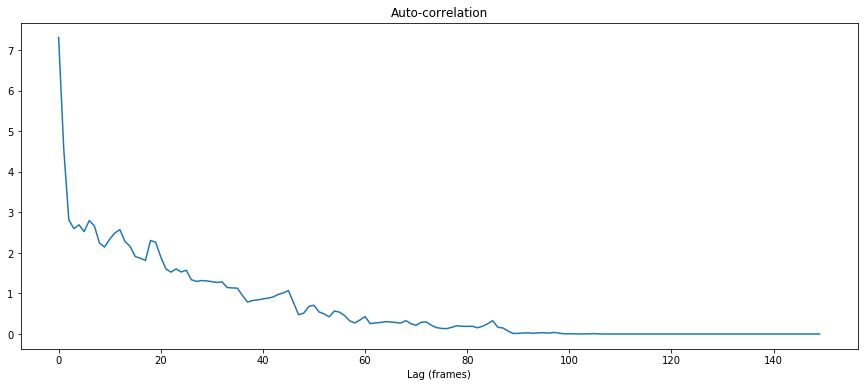

In [30]:
# Compute full autocorrelation of y

y, sr = librosa.load('LeadSamples-D4_Clean-17.1.wav')
librosa.autocorrelate(y)
# array([  3.226e+03,   3.217e+03, ...,   8.277e-04,   3.575e-04], dtype=float32)

# Compute onset strength auto-correlation up to 4 seconds


odf = librosa.onset.onset_strength(y=y, sr=sr, hop_length=512)
ac = librosa.autocorrelate(odf, max_size=4* sr / 512)
plt.plot(ac)
plt.title('Auto-correlation')
plt.xlabel('Lag (frames)')
plt.show()

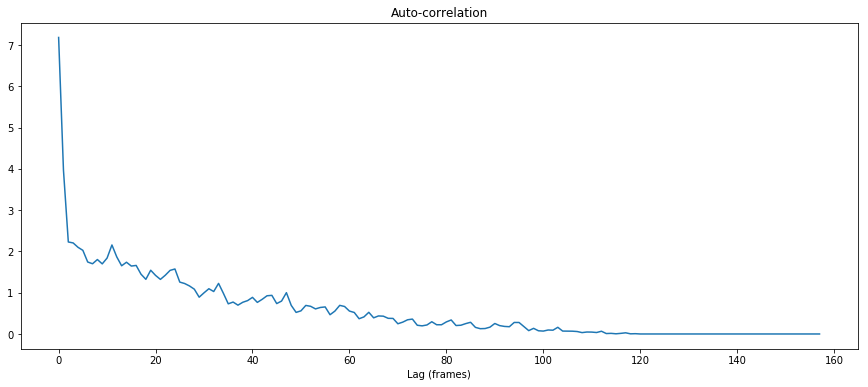

In [31]:
# Compute full autocorrelation of y

y, sr = librosa.load('LeadSamples-Eb4_Clean-19.8.wav')
librosa.autocorrelate(y)
# array([  3.226e+03,   3.217e+03, ...,   8.277e-04,   3.575e-04], dtype=float32)

# Compute onset strength auto-correlation up to 4 seconds


odf = librosa.onset.onset_strength(y=y, sr=sr, hop_length=512)
ac = librosa.autocorrelate(odf, max_size=4* sr / 512)
plt.plot(ac)
plt.title('Auto-correlation')
plt.xlabel('Lag (frames)')
plt.show()

# 1. Onset Detection

In [32]:
import essentia
from essentia.standard import *
audio1 = MonoLoader(filename='LeadSamples-C4_Clean-18.4.wav')()
audio2 = MonoLoader(filename='LeadSamples-D4_Clean-17.1.wav')()
audio3 = MonoLoader(filename='LeadSamples-Eb4_Clean-19.8.wav')()
audio_test = MonoLoader(filename='test_twinkle.wav')()
# Compute all features, aggregate only 'mean' and 'stdev' statistics for all low-level, rhythm and tonal frame features
features, features_frames = es.MusicExtractor(lowlevelStats=['mean', 'stdev'],
                                              rhythmStats=['mean', 'stdev'],
                                              tonalStats=['mean', 'stdev'])('test_twinkle.wav')

# See all feature names in the pool in a sorted order
print(sorted(features.descriptorNames()))

['lowlevel.average_loudness', 'lowlevel.barkbands.mean', 'lowlevel.barkbands.stdev', 'lowlevel.barkbands_crest.mean', 'lowlevel.barkbands_crest.stdev', 'lowlevel.barkbands_flatness_db.mean', 'lowlevel.barkbands_flatness_db.stdev', 'lowlevel.barkbands_kurtosis.mean', 'lowlevel.barkbands_kurtosis.stdev', 'lowlevel.barkbands_skewness.mean', 'lowlevel.barkbands_skewness.stdev', 'lowlevel.barkbands_spread.mean', 'lowlevel.barkbands_spread.stdev', 'lowlevel.dissonance.mean', 'lowlevel.dissonance.stdev', 'lowlevel.dynamic_complexity', 'lowlevel.erbbands.mean', 'lowlevel.erbbands.stdev', 'lowlevel.erbbands_crest.mean', 'lowlevel.erbbands_crest.stdev', 'lowlevel.erbbands_flatness_db.mean', 'lowlevel.erbbands_flatness_db.stdev', 'lowlevel.erbbands_kurtosis.mean', 'lowlevel.erbbands_kurtosis.stdev', 'lowlevel.erbbands_skewness.mean', 'lowlevel.erbbands_skewness.stdev', 'lowlevel.erbbands_spread.mean', 'lowlevel.erbbands_spread.stdev', 'lowlevel.gfcc.cov', 'lowlevel.gfcc.icov', 'lowlevel.gfcc.mean

In [33]:
# Phase 1: compute the onset detection function
# The OnsetDetection algorithm provides various onset detection functions. Let's use two of them.

od1 = OnsetDetection(method='hfc')
od2 = OnsetDetection(method='complex')

# Let's also get the other algorithms we will need, and a pool to store the results
w = Windowing(type = 'hann')
fft = FFT() # this gives us a complex FFT
c2p = CartesianToPolar() # and this turns it into a pair (magnitude, phase)
pool = essentia.Pool()

# Computing onset detection functions.
for frame in FrameGenerator(audio_test, frameSize = 1024, hopSize = 512):
    mag, phase, = c2p(fft(w(frame)))
    pool.add('features.hfc', od1(mag, phase))
    pool.add('features.complex', od2(mag, phase))

# Phase 2: compute the actual onsets locations
onsets = Onsets()

onsets_hfc = onsets(# this algo expects a matrix, not a vector
                    essentia.array([ pool['features.hfc'] ]),

                    # you need to specify weights, but as there is only a single
                    # function, it doesn't actually matter which weight you give it
                    [ 1 ])

onsets_complex = onsets(essentia.array([ pool['features.complex'] ]), [ 1 ])


# Mark onsets on the audio, which we'll write back to disk
# We use beeps instead of white noise and stereo signal as it's more distinctive

silence = [0.] * len(audio_test)

beeps_hfc = AudioOnsetsMarker(onsets=onsets_hfc, type='beep')(silence)
AudioWriter(filename='twinkle_onsets_hfc_stereo.wav', format='wav')(StereoMuxer()(audio_test, beeps_hfc))

beeps_complex = AudioOnsetsMarker(onsets=onsets_complex, type='beep')(silence)
AudioWriter(filename='twinkle_onsets_complex_stereo.wav', format='wav')(StereoMuxer()(audio_test, beeps_complex))


In [34]:
import IPython
IPython.display.Audio('test_twinkle.wav')

In [35]:
IPython.display.Audio('twinkle_onsets_hfc_stereo.wav')

In [36]:
IPython.display.Audio('twinkle_onsets_complex_stereo.wav')

0.011609977
0.55727893
1.1145579
1.2538775
1.6718367
1.8111565
2.2291157
2.3452153
2.7863946
2.9024944
3.3436735
3.4713833
4.4466214
5.0039
5.561179
6.1068482
6.664127
7.221406
7.7786846


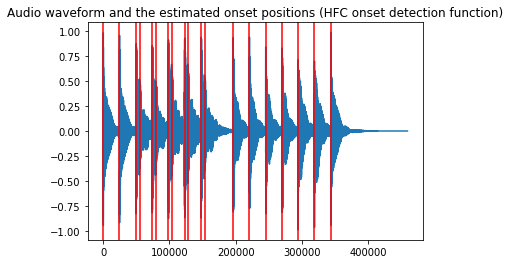

0.011609977
0.55727893
1.1145579
1.6718367
2.2291157
2.7747846
3.3320634
4.4466214
5.0039
5.549569
6.1068482
6.664127
7.221406
7.7786846


Text(0.5,1,'Audio waveform and the estimated onset positions (complex onset detection function)')

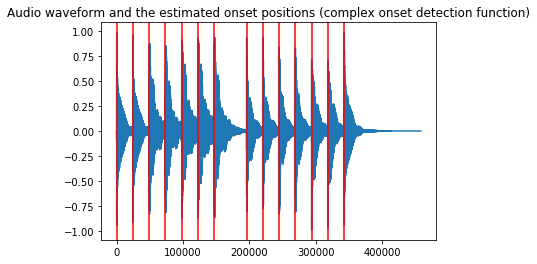

In [37]:
from pylab import plot, show, figure, imshow
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np

plot(audio_test)
for onset in onsets_hfc:
    print(onset)
    plt.axvline(x=onset*44100, color='red')

plt.title("Audio waveform and the estimated onset positions (HFC onset detection function)")
plt.show()

plot(audio_test)
for onset in onsets_complex:
    print(onset)
    plt.axvline(x=onset*44100, color='red')

plt.title("Audio waveform and the estimated onset positions (complex onset detection function)")

# 2. Pitch Detection

Duration of the audio sample [sec]:
10.402539682539683


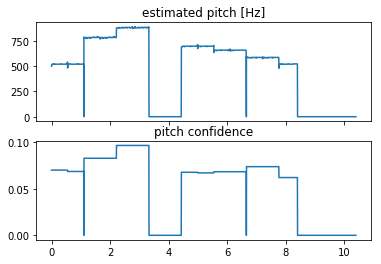

In [38]:
import numpy

# Load audio file; it is recommended to apply equal-loudness filter for PredominantPitchMelodia
loader = EqloudLoader(filename='test_twinkle.wav', sampleRate=44100)
audio = loader()
print("Duration of the audio sample [sec]:")
print(len(audio)/44100.0)

# Extract the pitch curve
# PitchMelodia takes the entire audio signal as input (no frame-wise processing is required)

pitch_extractor = PredominantPitchMelodia(frameSize=2048, hopSize=128)
pitch_values, pitch_confidence = pitch_extractor(audio)

# Pitch is estimated on frames. Compute frame time positions
pitch_times = numpy.linspace(0.0,len(audio)/44100.0,len(pitch_values) )

# Plot the estimated pitch contour and confidence over time
f, axarr = plt.subplots(2, sharex=True)
axarr[0].plot(pitch_times, pitch_values)
axarr[0].set_title('estimated pitch [Hz]')
axarr[1].plot(pitch_times, pitch_confidence)
axarr[1].set_title('pitch confidence')
plt.show()

In [39]:
print(pitch_values)

[499.62848 505.43393 511.30676 ...   0.        0.        0.     ]


In [40]:
print(onsets_complex)

[0.01160998 0.55727893 1.1145579  1.6718367  2.2291157  2.7747846
 3.3320634  4.4466214  5.0039     5.549569   6.1068482  6.664127
 7.221406   7.7786846 ]


[0.00000000e+00 2.90249433e-03 5.80498866e-03 ... 1.03967347e+01
 1.03996372e+01 1.04025397e+01]


# 3. Level detection


In [50]:
loader = EqloudLoader(filename='test_twinkle.wav', sampleRate=44100)
audio = loader()
print("Duration of the audio sample [sec]:")
print(len(audio)/44100.0)

Duration of the audio sample [sec]:
10.402539682539683


In [53]:
level_extractor = LevelExtractor()(audio)

In [54]:
print(level_extractor)

[5.8227440e+01 6.3566586e+01 5.6935951e+01 3.8235645e+01 3.8535351e+01
 4.8851418e+01 5.2000587e+01 3.4613991e+01 4.9800129e+00 3.3929653e-02]


# 4. Another way

In [55]:

%matplotlib inline

In [56]:
import essentia
import essentia.standard as es

import numpy

# For embedding audio player
import IPython

# Plots
import matplotlib.pyplot as plt
from pylab import plot, show, figure, imshow
plt.rcParams['figure.figsize'] = (15, 6) # Set plot sizes to something larger than default

In [57]:
filename = 'test_twinkle.wav'

In [58]:
# Load the whole file in mono
audio = es.MonoLoader(filename=filename)()
print(audio.shape)

(458752,)


In [59]:
# Load the whole file in stereo
audio, _, _, _, _, _ = es.AudioLoader(filename=filename)()
print(audio.shape)

(458752, 2)


In [61]:
# Load and resample to 16000 Hz
audio = es.MonoLoader(filename=filename, sampleRate=16000)()
print(audio.shape)

(166395,)


In [62]:

# This is how the audio we want to process sounds like
IPython.display.Audio('test_twinkle.wav')

In [63]:
# Compute all features, aggregate only 'mean' and 'stdev' statistics for all low-level, rhythm and tonal frame features
features, features_frames = es.MusicExtractor(lowlevelStats=['mean', 'stdev'], 
                                              rhythmStats=['mean', 'stdev'], 
                                              tonalStats=['mean', 'stdev'])('test_twinkle.wav')

# See all feature names in the pool in a sorted order
print(sorted(features.descriptorNames()))

['lowlevel.average_loudness', 'lowlevel.barkbands.mean', 'lowlevel.barkbands.stdev', 'lowlevel.barkbands_crest.mean', 'lowlevel.barkbands_crest.stdev', 'lowlevel.barkbands_flatness_db.mean', 'lowlevel.barkbands_flatness_db.stdev', 'lowlevel.barkbands_kurtosis.mean', 'lowlevel.barkbands_kurtosis.stdev', 'lowlevel.barkbands_skewness.mean', 'lowlevel.barkbands_skewness.stdev', 'lowlevel.barkbands_spread.mean', 'lowlevel.barkbands_spread.stdev', 'lowlevel.dissonance.mean', 'lowlevel.dissonance.stdev', 'lowlevel.dynamic_complexity', 'lowlevel.erbbands.mean', 'lowlevel.erbbands.stdev', 'lowlevel.erbbands_crest.mean', 'lowlevel.erbbands_crest.stdev', 'lowlevel.erbbands_flatness_db.mean', 'lowlevel.erbbands_flatness_db.stdev', 'lowlevel.erbbands_kurtosis.mean', 'lowlevel.erbbands_kurtosis.stdev', 'lowlevel.erbbands_skewness.mean', 'lowlevel.erbbands_skewness.stdev', 'lowlevel.erbbands_spread.mean', 'lowlevel.erbbands_spread.stdev', 'lowlevel.gfcc.cov', 'lowlevel.gfcc.icov', 'lowlevel.gfcc.mean

In [64]:
print("Filename:", features['metadata.tags.file_name'])
print("-"*80)
print("Replay gain:", features['metadata.audio_properties.replay_gain'])
print("EBU128 integrated loudness:", features['lowlevel.loudness_ebu128.integrated'])
print("EBU128 loudness range:", features['lowlevel.loudness_ebu128.loudness_range'])
print("-"*80)
print("MFCC mean:", features['lowlevel.mfcc.mean'])
print("-"*80)
print("BPM:", features['rhythm.bpm'])
print("Beat positions (sec.)", features['rhythm.beats_position'])
print("-"*80)
print("Key/scale estimation (using a profile specifically suited for electronic music):", 
      features['tonal.key_edma.key'], features['tonal.key_edma.scale'])

Filename: test_twinkle.wav
--------------------------------------------------------------------------------
Replay gain: -13.869844436645508
EBU128 integrated loudness: -13.354763984680176
EBU128 loudness range: 4.60551643371582
--------------------------------------------------------------------------------
MFCC mean: [-1.0626448e+03  1.7374055e+02  9.7626084e-01 -5.2661896e+01
 -4.4416115e+01 -4.4377815e+01 -3.2838860e+01 -1.6441963e+01
 -1.2569188e+01 -4.7544246e+00  1.3902512e+00 -9.4691820e+00
 -1.8678413e+01]
--------------------------------------------------------------------------------
BPM: 108.20501708984375
Beat positions (sec.) [0.5572789 1.1145577 1.6718367 2.2291155 2.7863946 3.3436735 3.8893423
 4.4350114 4.99229   5.549569  6.106848  6.664127  7.221406  7.7786846
 8.324353  8.870023  9.427301  9.98458  ]
--------------------------------------------------------------------------------
Key/scale estimation (using a profile specifically suited for electronic music): C majo

In [65]:
# Loading audio file
audio = es.MonoLoader(filename='test_twinkle.wav')()

# Compute beat positions and BPM
rhythm_extractor = es.RhythmExtractor2013(method="multifeature")
bpm, beats, beats_confidence, _, beats_intervals = rhythm_extractor(audio)

print("BPM:", bpm)
print("Beat positions (sec.):", beats)
print("Beat estimation confidence:", beats_confidence)

# Mark beat positions on the audio and write it to a file
# Let's use beeps instead of white noise to mark them, as it's more distinctive
marker = es.AudioOnsetsMarker(onsets=beats, type='beep')
marked_audio = marker(audio)
es.MonoWriter(filename='test_twinkle.wav')(marked_audio)

BPM: 108.20501708984375
Beat positions (sec.): [0.5572789 1.1145577 1.6718367 2.2291155 2.7863946 3.3436735 3.8893423
 4.4350114 4.99229   5.549569  6.106848  6.664127  7.221406  7.7786846
 8.324353  8.870023  9.427301  9.98458  ]
Beat estimation confidence: 2.3107545375823975


Text(0.5,1,'Audio waveform and the estimated beat positions')

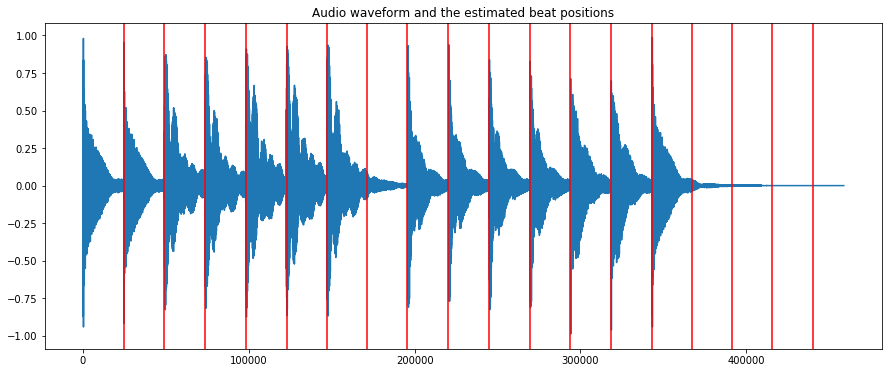

In [66]:
plot(audio)
for beat in beats:
    plt.axvline(x=beat*44100, color='red')

plt.title("Audio waveform and the estimated beat positions")

Overall BPM (estimated before): 108.2
First histogram peak: 108.0 bpm
Second histogram peak: 0.0 bpm


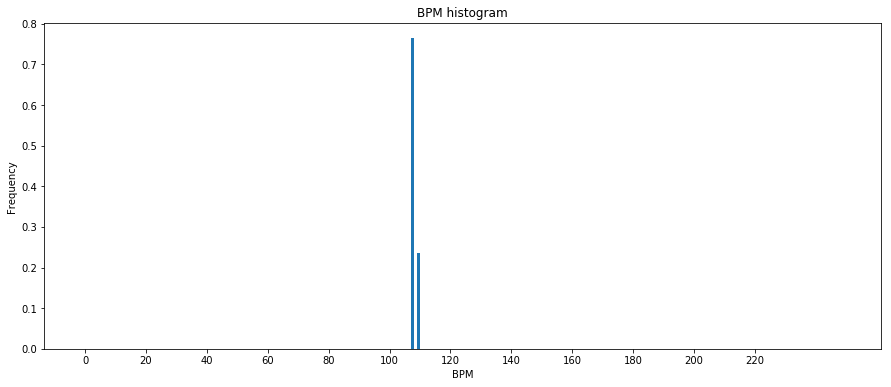

In [67]:
peak1_bpm, peak1_weight, peak1_spread,\
peak2_bpm, peak2_weight, peak2_spread, histogram = es.BpmHistogramDescriptors()(beats_intervals)

print("Overall BPM (estimated before): %0.1f" % bpm)
print("First histogram peak: %0.1f bpm" % peak1_bpm)
print("Second histogram peak: %0.1f bpm" % peak2_bpm)

fig, ax = plt.subplots()
ax.bar(range(len(histogram)), histogram, width=1)
ax.set_xlabel('BPM')
ax.set_ylabel('Frequency')
plt.title("BPM histogram")
ax.set_xticks([20 * x + 0.5 for x in range(int(len(histogram) / 20))])
ax.set_xticklabels([str(20 * x) for x in range(int(len(histogram) / 20))])
plt.show()

In [68]:
audio = es.MonoLoader(filename='test_twinkle.wav')()
bpm = es.PercivalBpmEstimator()(audio)
print("BPM:", bpm)

BPM: 107.94712829589844


Duration of the audio sample [sec]: 10.402539682539683


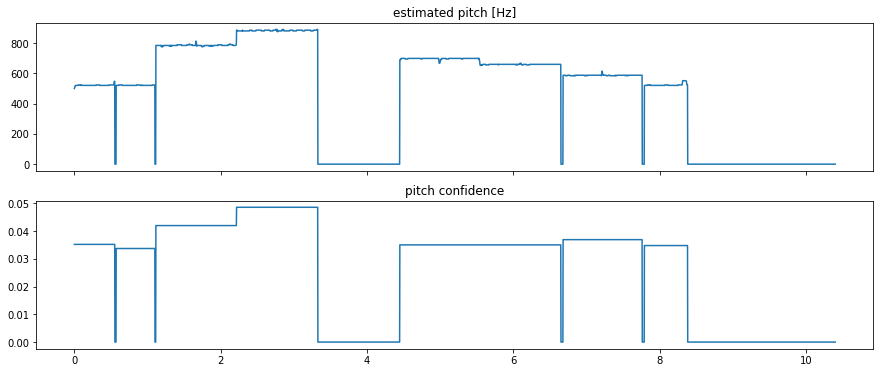

In [69]:
# Load audio file; it is recommended to apply equal-loudness filter for PredominantPitchMelodia 
loader = es.EqloudLoader(filename='test_twinkle.wav', sampleRate=44100)

audio = loader()
print("Duration of the audio sample [sec]:", len(audio)/44100.0)

# Extract the pitch curve
# PitchMelodia takes the entire audio signal as input (no frame-wise processing is required)

pitch_extractor = es.PredominantPitchMelodia(frameSize=2048, hopSize=128)
pitch_values, pitch_confidence = pitch_extractor(audio)

# Pitch is estimated on frames; the first frame centered at zero. Compute frame time positions
#pitch_times = [128/44100. * i for i in range(len(pitch_values))]
pitch_times = numpy.arange(0,len(pitch_values)) * 128/44100.

# Plot the estimated pitch contour and confidence over time
f, axarr = plt.subplots(2, sharex=True)
axarr[0].plot(pitch_times, pitch_values)
axarr[0].set_title('estimated pitch [Hz]')
axarr[1].plot(pitch_times, pitch_confidence)
axarr[1].set_title('pitch confidence')
plt.show()

In [70]:
from mir_eval.sonify import pitch_contour

# Essentia operates with float32 ndarrays instead of float64, so let's cast it
synthesized_melody = pitch_contour(pitch_times, pitch_values, 44100).astype(numpy.float32)[:len(audio)]
es.AudioWriter(filename='test_twinkle.wav', format='wav')(es.StereoMuxer()(audio, synthesized_melody))

IPython.display.Audio('test_twinkle.wav')

In [71]:
onsets, durations, notes = es.PitchContourSegmentation(hopSize=128)(pitch_values, audio)
print(notes) # Midi pitch number
print(onsets)
print(durations)

[72. 72. 79. 81. 77. 77. 76. 74. 74. 72.]
[0.        0.5717914 1.1145579 2.2204082 4.449524  4.989388  5.5466666
 6.681542  7.215601  7.793197 ]
[0.5514739  0.528254   1.1000453  1.1058503  0.5340589  0.5514739
 1.1029478  0.528254   0.54566896 0.58920634]


In [72]:
import mido

PPQ = 96 # Pulses per quarter note
BPM = 120 # Assuming a default tempo in Ableton to build a MIDI clip
tempo = mido.bpm2tempo(BPM) # Microseconds per beat

# Compute onsets and offsets for all MIDI notes in ticks
# Relative tick positions start from time 0
offsets = onsets + durations
silence_durations = list(onsets[1:] - offsets[:-1]) + [0]

mid = mido.MidiFile()
track = mido.MidiTrack()
mid.tracks.append(track)

for note, onset, duration, silence_duration in zip(list(notes), list(onsets), list(durations), silence_durations):
    track.append(mido.Message('note_on', note=int(note), velocity=64, 
                              time=int(mido.second2tick(duration, PPQ, tempo))))
    track.append(mido.Message('note_off', note=int(note), 
                              time=int(mido.second2tick(silence_duration, PPQ, tempo))))

mid.save('extracted_melody.mid')

In [73]:
filename = 'test_twinkle.wav'
import IPython
IPython.display.Audio(filename)

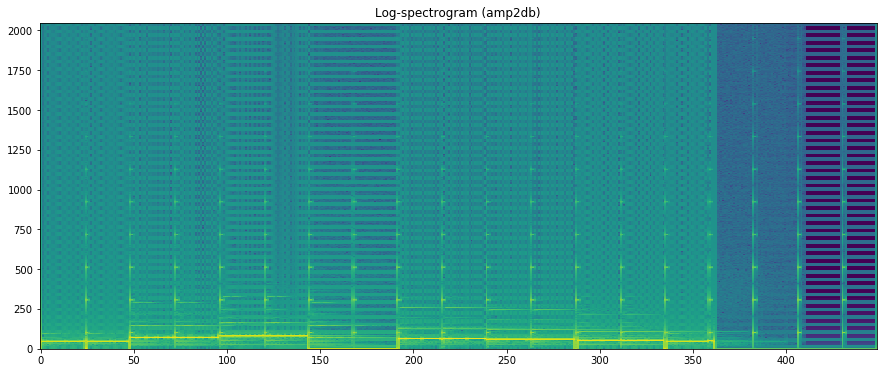

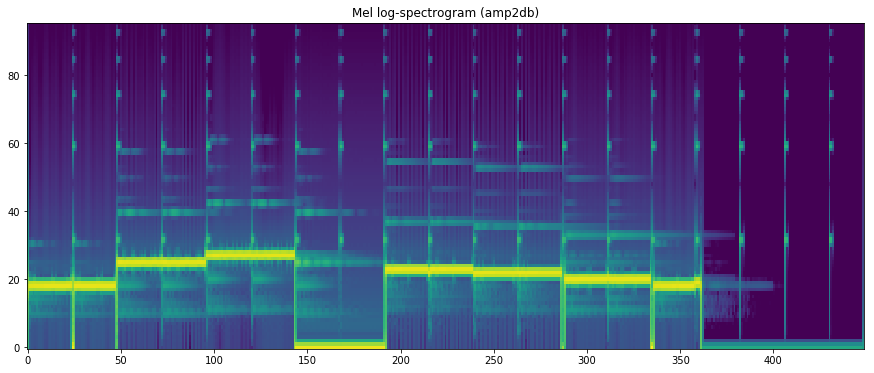

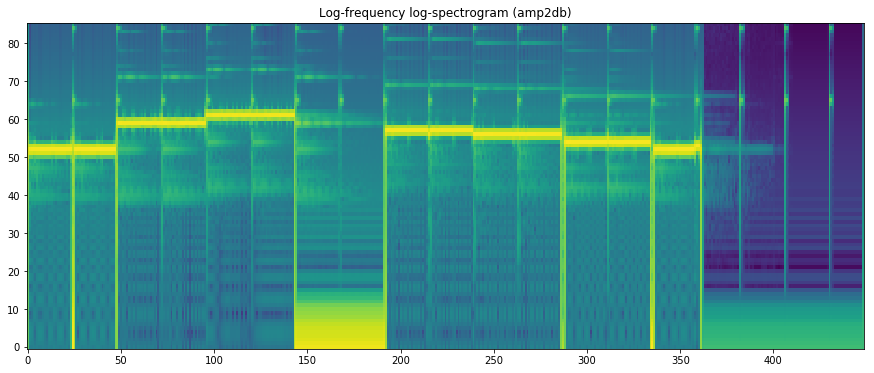

In [74]:
audio = es.MonoLoader(filename=filename)()
windowing = es.Windowing(type='blackmanharris62', zeroPadding=2048)
spectrum = es.Spectrum()
melbands = es.MelBands(numberBands=96, lowFrequencyBound=0, highFrequencyBound=11000)
spectrum_logfreq = es.LogSpectrum(binsPerSemitone=1)

amp2db = es.UnaryOperator(type='lin2db', scale=2)
pool = essentia.Pool()

for frame in es.FrameGenerator(audio, frameSize=2048, hopSize=1024):
    frame_spectrum = spectrum(windowing(frame))
    frame_mel = melbands(frame_spectrum)
    frame_spectrum_logfreq, _, _ = spectrum_logfreq(frame_spectrum)
    
    pool.add('spectrum_db', amp2db(frame_spectrum))
    pool.add('mel96_db', amp2db(frame_mel))
    pool.add('spectrum_logfreq_db', amp2db(frame_spectrum_logfreq))

imshow(pool['spectrum_db'].T, aspect = 'auto', origin='lower', interpolation='none')
plt.title("Log-spectrogram (amp2db)")
show()

imshow(pool['mel96_db'].T, aspect = 'auto', origin='lower', interpolation='none')
plt.title("Mel log-spectrogram (amp2db)")
show()

imshow(pool['spectrum_logfreq_db'].T, aspect = 'auto', origin='lower', interpolation='none')
plt.title("Log-frequency log-spectrogram (amp2db)")
show()


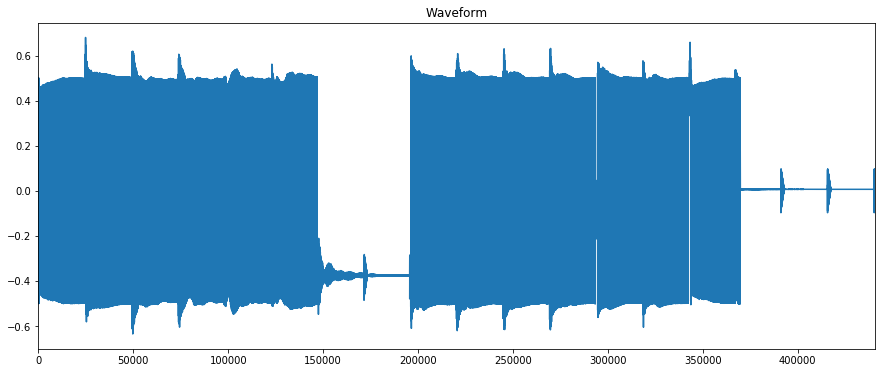

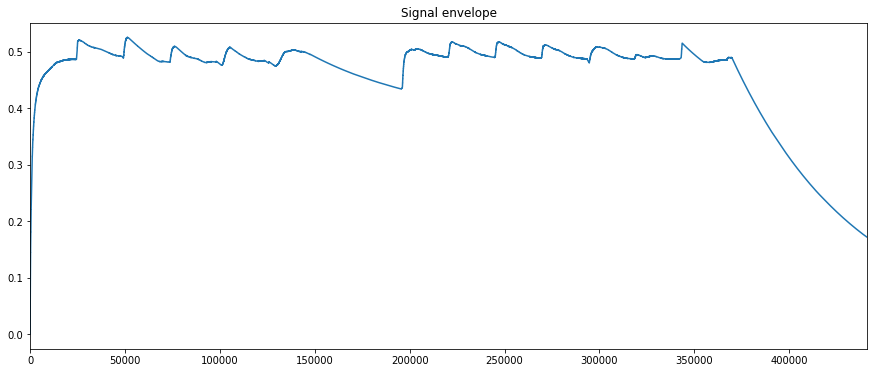

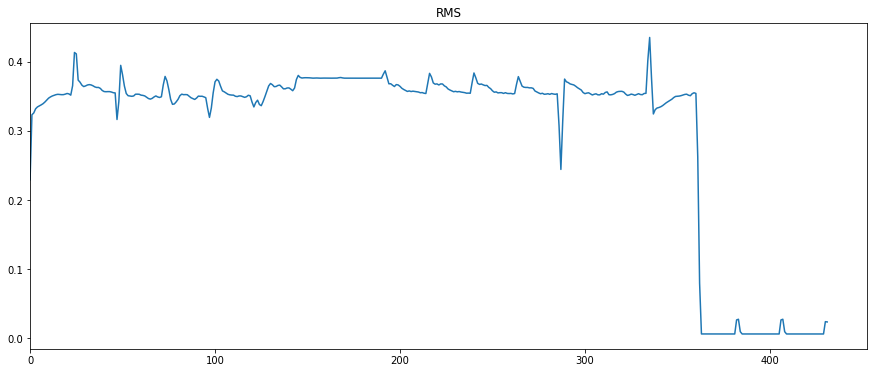

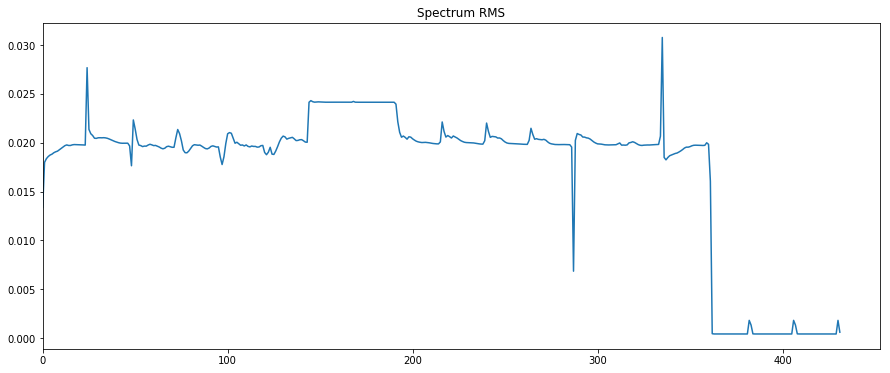

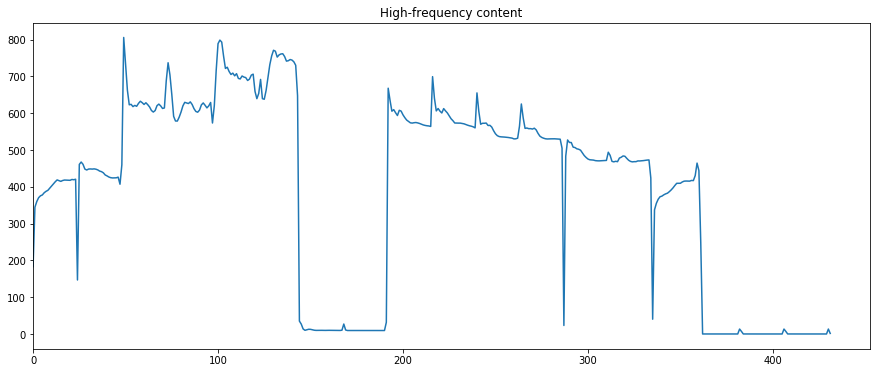

In [75]:
# Let's load only the first 10 second of audio this time
SEGMENT_LENGTH = 10
audio = es.EasyLoader(filename=filename, startTime=0, endTime=SEGMENT_LENGTH)()
pool = essentia.Pool()

rms = es.RMS()
hfc = es.HFC()

for frame in es.FrameGenerator(audio, frameSize=2048, hopSize=1024):
    frame_spectrum = spectrum(windowing(frame))

    pool.add('rms', rms(frame))
    pool.add('rms_spectrum', rms(frame_spectrum))
    pool.add('hfc', hfc(frame_spectrum))
    
plot(audio)
plt.xlim(0, 44100 * SEGMENT_LENGTH)
plt.title("Waveform")
show()

envelope = es.Envelope()
plot(envelope(audio))
plt.xlim(0, 44100 * SEGMENT_LENGTH)
plt.title("Signal envelope")
show()

plot(pool['rms'])
plt.title("RMS")
plt.xlim(0)
show()

plot(pool['rms_spectrum'])
plt.title("Spectrum RMS")
plt.xlim(0)
show()

plot(pool['hfc'])
plt.title("High-frequency content")
plt.xlim(0)
show()

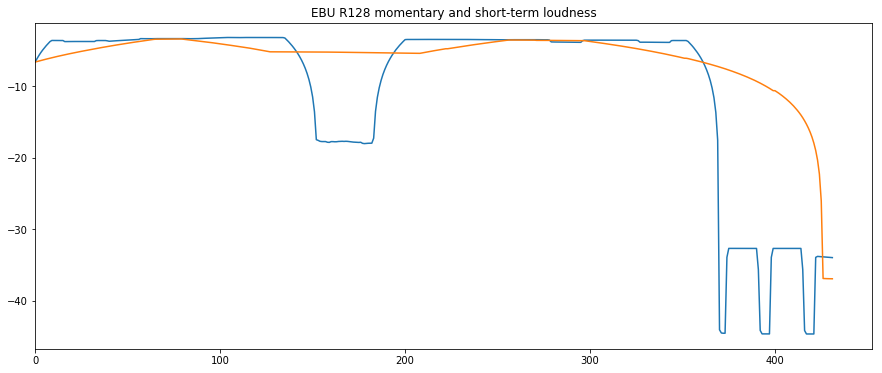

In [79]:
# LoudnessEBUR128 requires stereo in 44100 Hz sample rate
audio_st, _, _, _, _, _ = es.AudioLoader(filename=filename)()
audio_st = es.StereoTrimmer(startTime=0, endTime=SEGMENT_LENGTH)(audio_st)
ebu_momentary, ebu_shortterm, ebu_integrated, dr = es.LoudnessEBUR128(hopSize=1024/44100, startAtZero=True)(audio_st)

plot(ebu_momentary)
plot(ebu_shortterm)
plt.title("EBU R128 momentary and short-term loudness")
plt.xlim(0)
show()

In [80]:

print("Integrated loudness:", ebu_integrated)
print("Dynamic range:", dr)

Integrated loudness: -3.8986377716064453
Dynamic range: 4.875300884246826
